# Interactive Urban Flood Predictor

In [1]:
import tensorflow as tf
import numpy as np
import os
from os.path import join
import math

import matplotlib

import matplotlib.pylab as plt

# import ipywidgets (interaction library)
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets

from scipy.stats import norm

# import neural net code
import nn
import nn_model_new as nn_model
import load_data

import cv2

#time measurement
import time

import statistics

import cmocean

matplotlib.__version__

'3.0.3'

## 1. The CNN Model

### select one cell to load

luzern trained with terrain features

In [2]:
# files
rain_file = "data/luzern/rain_pattern_str.txt"
dem_file = "data/luzern/dem/luzern.asc.gz"
waterdepth_path = "data/luzern/waterdepth"

model_path = "model2"
model_name = "luzern_256_features"

dem_process_func = load_data.generate_features
dem_channels = load_data.channels_generate_features

luzern train with dem only

In [18]:
# files
rain_file = "data/luzern/rain_pattern_str.txt"
dem_file = "data/luzern/dem/luzern.asc.gz"
waterdepth_path = "data/luzern/waterdepth"

model_path = "model2"
model_name = "luzern_256_neg_pos"

dem_process_func = load_data.rescale_dem_negative_positive
dem_channels = load_data.channels_rescale_dem_negative_positive

zurich trained with terrain features

In [18]:
# files
rain_file = "data/744/rain_pattern_str.txt"
dem_file = "data/744/dem/744_dem_asc.asc.gz"
waterdepth_path = "data/744/waterdepth"

model_path = "model2"
model_name = "zurich_256_features"

dem_process_func = load_data.generate_features
dem_channels = load_data.channels_generate_features

portugal trained with terrain features

In [22]:
# files
rain_file = "data/portugal/rain_pattern_str.txt"
dem_file = "data/portugal/dem/dem.asc.gz"
waterdepth_path = "data/portugal/waterdepth"

model_path = "model2"
model_name = "coimbra_256_features"

dem_process_func = load_data.generate_features
dem_channels = load_data.channels_generate_features

portugal trained with terrain features, load real rain event for testing

In [2]:
# files
rain_file = "data/portugal/real/rain_pattern_real.txt"
dem_file = "data/portugal/dem/dem.asc.gz"
waterdepth_path = "data/portugal/real/waterdepth"

model_path = "model2"
model_name = "coimbra_256_features"

dem_process_func = load_data.generate_features
dem_channels = load_data.channels_generate_features

### select one model to load

256x256 input

In [3]:
# parameters
patch_size = 256
input_channel = dem_channels
output_channel = 1 # water level
vector_length = 12

lin_size = [4096] # 4096 = 32 * 32 * 4
reshape_size = [32,32,4] # reshape_size is determined by patch_size / pooling_size / .. / pooling_size, which is 32

net_channel = [32,64,128]
kernel_size = [[3,3],[3,3],[3,3]]
pooling_size = [[2,2],[2,2],[2,2]] # size of the latent layer: patch_size / pooling_size / .. / pooling_size = 32

# the cnn model used for training and testing
initializer = tf.contrib.layers.xavier_initializer()
af = tf.nn.leaky_relu
phs, ls, vs = nn_model.prediction_network([patch_size, patch_size, input_channel],vector_length, lin_size, reshape_size, net_channel, output_channel, kernel_size, pooling_size, initializer, af)

	 Tensor("encode-0_c_0:0", shape=(?, 256, 256, 32), dtype=float32)
	 Tensor("encode-0_c_1:0", shape=(?, 256, 256, 32), dtype=float32)
	 Tensor("encode-0:0", shape=(?, 128, 128, 32), dtype=float32)
Tensor("encode-0:0", shape=(?, 128, 128, 32), dtype=float32)
	 Tensor("encode-1_c_0:0", shape=(?, 128, 128, 64), dtype=float32)
	 Tensor("encode-1_c_1:0", shape=(?, 128, 128, 64), dtype=float32)
	 Tensor("encode-1:0", shape=(?, 64, 64, 64), dtype=float32)
Tensor("encode-1:0", shape=(?, 64, 64, 64), dtype=float32)
	 Tensor("encode-2_c_0:0", shape=(?, 64, 64, 128), dtype=float32)
	 Tensor("encode-2_c_1:0", shape=(?, 64, 64, 128), dtype=float32)
	 Tensor("encode-2:0", shape=(?, 32, 32, 128), dtype=float32)
Tensor("encode-2:0", shape=(?, 32, 32, 128), dtype=float32)
Tensor("l-0:0", shape=(?, 4096), dtype=float32)
Tensor("concat:0", shape=(?, 32, 32, 132), dtype=float32)
output shape [64, 64]
	 Tensor("decode-2_dc_:0", shape=(?, 64, 64, 132), dtype=float32)
	 Tensor("decode-2_c_0:0", shape=(?, 64,

512x512 input

In [ ]:
# parameters
patch_size = 512
input_channel = dem_channels
output_channel = 1 # water level
vector_length = 12

lin_size = [4096] # 4096 = 32 * 32 * 4
reshape_size = [32,32,4] # reshape_size is determined by patch_size / pooling_size / .. / pooling_size, which is 32

net_channel = [32,64,128,128]
kernel_size = [[3,3],[3,3],[3,3],[3,3]]
pooling_size = [[2,2],[2,2],[2,2],[2,2]] # size of the latent layer: patch_size / pooling_size / .. / pooling_size = 32

# the cnn model used for training and testing
initializer = tf.contrib.layers.xavier_initializer()
af = tf.nn.leaky_relu
phs, ls, vs = nn_model.prediction_network([patch_size, patch_size, input_channel],vector_length, lin_size, reshape_size, net_channel, output_channel, kernel_size, pooling_size, initializer, af)

## 2.  Load Data

### 2.1 Restore CNN Model

In [4]:
model_id = "/-79"

sess=tf.Session()
tf.global_variables_initializer().run(session=sess)
saver = tf.train.Saver()
saver.restore(sess,join(model_path,model_name+model_id))

INFO:tensorflow:Restoring parameters from model2\luzern_256_features/-79


### 2.2 Load DEM Data

In [5]:
dem_array = load_data.load_dem(dem_file)
mask_indice = dem_array<0
dem_array = dem_process_func(dem_array)

loading data/luzern/dem/luzern.asc.gz
(3369, 3110)
generating features


In [6]:
def render(nd_array, cmap, vmin=0, vmax = 1, mask_indice=None):
    nd_array = (cmap((nd_array - vmin) / (vmax - vmin))*255).astype(np.uint8)
    if mask_indice is not None:
        nd_array[mask_indice] *= 0
    return nd_array

def render_by_threshold(nd_array, threshold,mask_indice=None):
    output = np.copy(nd_array)
    output[output<threshold] = 0
    output[output>=threshold] -= threshold
    
    return render(output, plt.cm.seismic, vmin=-1, vmax=1, mask_indice=mask_indice)

def save_png(filename, nd_array):
    cv2.imwrite(filename,cv2.cvtColor(nd_array,cv2.COLOR_RGBA2BGRA))

measure the avg time spent on generating features

In [18]:
n = 10
data = load_data.load_dem(dem_file)
start = time.time()
for _ in range(n):
    dem_process_func(data)
end = time.time()

print ((end-start)/n)

del data

loading data/portugal/dem/dem.asc.gz
(1625, 2603)
generating features
generating features
generating features
generating features
generating features
generating features
generating features
generating features
generating features
generating features
0.6360344886779785


### 2.3 Load Rainfall Data

In [7]:
rainfall_name, rainfall_intensity = load_data.rainfall_pattern(rain_file)

### 2.4 Load Real Rainfall Data

In [5]:
def read_real_rain(file):
    with open(file) as f:
        lines = f.readlines()
    arr = [l.split("\t") for l in lines]
    #print(arr)
    name = {i:arr[i][0] for i in range(len(arr))}
    rainfall_intensity = [[float(a[i]) for i in range(1, len(a))] for a in arr]
    rainfall_intensity = [np.array(r) for r in rainfall_intensity]
    
    #print(name)
    #print(rainfall_intensity)
    
    return name, rainfall_intensity

#from scipy import interpolate
rainfall_name, rainfall_intensity_orig = read_real_rain(rain_file)
#fs = [interpolate.interp1d(np.arange(len(r))/(len(r)-1),r) for r in rainfall_intensity_orig]
#rainfall_intensity = [f(np.arange(12)/11) for f in fs]
rainfall_intensity = [np.interp(np.arange(12)/11, np.arange(len(r))/(len(r)-1),r) for r in rainfall_intensity_orig]

print (rainfall_intensity_orig)
print (rainfall_intensity)

[array([24.239994, 60.6     , 23.027994, 10.908   ,  3.636   ,  2.424   ,
        1.212   ]), array([  0.,  36.,   0.,   0.,  78., 132., 132., 144., 102., 102.,  30.,
        12.,  18.,  18.,  48.,  72.,  60.,  90.,  48.,  66.,  66.,  36.,
        24.,  24.,  36.,  30.,  24., 102., 108., 102.,  72.,  48.,  18.,
         6.,  36.,  24.,  24.,  18.,  12.,  54.,  36.,  36.,  12.,   6.,
         0.,   0.,   0.,   6.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
         0.,   0.,   6.,   0.,   0.,   0.]), array([ 0.      ,  9.696   , 38.784006, 61.812   , 31.512   ,  3.636   ,
        0.      ])]
[array([24.239994  , 44.07272455, 57.18436309, 36.69054164, 20.82435873,
       14.21345291,  8.92472727,  4.95818182,  3.19527273,  2.53418182,
        1.87309091,  1.212     ]), array([  0.        , 132.        ,  13.63636364,  70.90909091,
        26.18181818, 103.63636364,   9.27272727,  19.63636364,
         2.18181818,   0.        ,   0.        ,   0.        ]), array([ 0.        ,  5.28872727,

## 3. Make Predictions

### 3.1 Functions

In [8]:
def generate_patches(dem_array, patch_step = patch_size):
    height, width, _ = dem_array.shape
    # generate patch locations
    patches=[]
    # generate patch locations
    patches = [[min(h,height-patch_size-1),min(w,width-patch_size-1)] for h in range(0, height,patch_step) for w in range(0, width, patch_step)]
    # select those that contains catchment areas
    patches = [[h, w] for h, w in patches if np.any(dem_array[h:h+patch_size,w:w+patch_size,0])]
    return np.array(patches,dtype=np.uint32)

class mean_estimator():
    def __init__(self, dem_array):
        height, width, _ = dem_array.shape
        self.sum_x = np.zeros((height,width), dtype=np.float32)
        #self.sum_x2 = np.zeros((height,width), dtype=np.float32)
        self.n_x = np.zeros((height,width), dtype=np.uint32)

    def put_patch(self, h,w , patch):
        ph, pw = patch.shape
        # print (ph, pw, self.sum_x[h:h+ph,w:w+pw].shape, patch.shape)
        self.sum_x[h:h+ph,w:w+pw] += patch
        #self.sum_x2[h:h+ph,w:w+pw] += np.square(patch)
        self.n_x[h:h+ph,w:w+pw] += 1

    def get_result(self):
        mean_x = np.copy(self.sum_x)
        mean_x[self.n_x>0] /= self.n_x[self.n_x>0]
        return mean_x

class stddev_calculator():
    def __init__(self, dem_array):
        height, width, _ = dem_array.shape
        self.sum_x = np.zeros((height,width), dtype=np.float32)
        self.sum_x2 = np.zeros((height,width), dtype=np.float32)
        self.n_x = np.zeros((height,width), dtype=np.uint32)
        self.stddev = np.zeros((height,width), dtype=np.float32)

    def put_patch(self, h,w , patch):
        ph, pw = patch.shape
        # print (ph, pw, self.sum_x[h:h+ph,w:w+pw].shape, patch.shape)
        self.sum_x[h:h+ph,w:w+pw] += patch
        self.sum_x2[h:h+ph,w:w+pw] += np.square(patch)
        self.n_x[h:h+ph,w:w+pw] += 1

    def get_result(self):
        indice = self.n_x > 0
        self.stddev.fill(0)
        
        # stddev = sqrt(sum_x2/n_x - (sum_x/n_x)^2)
        # use abs here to prevent numerical instaibility
        self.stddev[indice] = np.sqrt(np.abs(self.sum_x2[indice]/self.n_x[indice] - np.square(self.sum_x[indice]/self.n_x[indice])))
        
        return self.stddev
    
class max_estimator():
    def __init__(self, dem_array):
        height, width, _ = dem_array.shape
        self.max_x = np.zeros((height,width), dtype=np.float32)

    def put_patch(self, h, w, patch):
        ph, pw = patch.shape
        self.max_x[h:h+ph,w:w+pw] = np.maximum(self.max_x[h:h+ph,w:w+pw],patch)
        
    def get_result(self):
        return self.max_x
    
class median_estimator():
    def __init__(self, dem_array, buffer=4):
        height, width, _ = dem_array.shape
        
        self.n_x = np.zeros((height,width), dtype=np.uint32)
        self.values_x = np.empty((height,width,buffer), dtype=np.float32)
        self.values_x.fill(np.nan)
        
    def ensure_space(self):
        height,width,buffer = self.values_x.shape
        if self.n_x.max() == buffer:
            values_x = self.values_x
            self.values_x = np.empty((height,width,buffer*2), dtype=np.float32)
            self.values_x.fill(np.nan)
            
            self.values_x[:,:,:buffer] = values_x
    
    def put_patch(self, h, w, patch):
        self.ensure_space()
        ph, pw = patch.shape
        
        # see the test code below about these axes
        axes0 = np.arange(h,h+ph)[:,np.newaxis]*np.ones((ph,pw),np.uint32)
        axes1 = np.arange(w,w+pw)*np.ones((ph,pw),np.uint32)
        axes2 = self.n_x[h:h+ph,w:w+pw]
        
        # fill the lowest nan value with patch value
        self.values_x[axes0,axes1,axes2] = patch
        # update counting
        self.n_x[h:h+ph,w:w+pw] += 1
        
    def get_result(self):
        # calculate median by ignoreing nans
        median = np.nanmedian(self.values_x, axis=2)
        median[np.isnan(median)] = 0
        return median

# test codes
h = 3
w = 2

ph = 4
pw = 5

axes0 = np.arange(h,h+ph)[:,np.newaxis]*np.ones((ph,pw),np.uint32)
axes1 = np.arange(w,w+pw)*np.ones((ph,pw),np.uint32)

print(axes0,"\n\n\n", axes1)

[[3 3 3 3 3]
 [4 4 4 4 4]
 [5 5 5 5 5]
 [6 6 6 6 6]] 


 [[2 3 4 5 6]
 [2 3 4 5 6]
 [2 3 4 5 6]
 [2 3 4 5 6]]


In [9]:
def make_prediction(dem_array, rain_pattern_vector, batch_size=32, method="mean", patch_step=patch_size):
    estimator = None
    
    if method == "mean":
        estimator = mean_estimator(dem_array)
    elif method == "median":
        estimator = median_estimator(dem_array)
    elif method == "max":
        estimator = max_estimator(dem_array)
    elif method == "stddev":
        estimator = stddev_calculator(dem_array)
    else:
        raise Exception('unsupported method!')
    
    # generate patches
    patches = generate_patches(dem_array, patch_step)
    num_patches = len(patches)
    
    # run the cnn
    for i in range(0, num_patches, batch_size):
        start = i
        end = min(i+batch_size, num_patches-1)
        # print(start,end,num_patches)

        x1 = np.array([dem_array[patches[j,0]:patches[j,0]+patch_size,patches[j,1]:patches[j,1]+patch_size] for j in range(start,end)])
        x2 = np.array([rain_pattern_vector for _ in range(end-start)])

        result = sess.run(ls["prediction"], feed_dict={phs["x1"]:x1,phs["x2"]:x2})
        # print (result.shape)
        for j in range(end-start):
            h,w = patches[start + j]
            estimator.put_patch(h,w,result[j])
    
    return estimator.get_result()

In [10]:
def render_prediction(mask_indice, output, rain_pattern_vector, target_array=None, img_height = 20, threshold = None):
    height, width = output.shape
    
    if threshold is not None:
        output[output<threshold] = 0
        output[output>=threshold] -= threshold
    
    output[mask_indice]=np.nan
    
    if target_array is None:    
        plt.figure(figsize=(2 * math.ceil(width / height * img_height),img_height))
        plt.subplot(1,2,1)
        plt.gca().set_title("rainfall pattern")
        plt.plot(rain_pattern_vector)
        
        plt.subplot(1,2,2)
        plt.gca().set_title("prediction")
        if threshold is not None:
            plt.imshow(output, cmap=plt.cm.seismic,vmin=-1,vmax=1)
        else:
            plt.imshow(output, cmap=plt.cm.terrain,vmin=0,vmax=5)

    else:
        
        if threshold is not None:
            target_array[target_array<threshold] = 0
            target_array[target_array>=threshold] -= threshold

        target_array[mask_indice]=np.nan
        
        plt.figure(figsize=(2 * math.ceil(width / height * img_height),2 * img_height))
        plt.subplot(2,2,1)
        plt.gca().set_title("prediction")
        
        if threshold is not None:
            plt.imshow(output, cmap=plt.cm.seismic,vmin=threshold-3,vmax=threshold+3)
        else:
            plt.imshow(output, cmap=plt.cm.terrain,vmin=0,vmax=5)
        
        plt.subplot(2,2,2)
        plt.gca().set_title("target")
        
        if threshold is not None:
            plt.imshow(target_array, cmap=plt.cm.seismic,vmin=-1,vmax=1)
        else:
            plt.imshow(target_array, cmap=plt.cm.terrain,vmin=0,vmax=5)
        
        plt.subplot(2,2,3)
        plt.gca().set_title("rainfall pattern")
        plt.plot(rain_pattern_vector)
        
        plt.subplot(2,2,4)
        plt.gca().set_title("error [-1, 1]")
        plt.imshow(target_array - output, cmap=plt.cm.seismic,vmin=-1,vmax=1)
    plt.show()

In [11]:
def render_prediction2(mask_indice, output, rain_pattern_vector, target_array=None, img_height = 20, threshold = None):
    '''
    for screen recording only
    '''
    height, width = output.shape
    
    if threshold is not None:
        output[output<threshold] = 0
        output[output>=threshold] -= threshold
    
    output[mask_indice]=np.nan
    
    if target_array is None:    
        plt.figure(figsize=(math.ceil(width / height * img_height),img_height))
        plt.gca().set_title("prediction")
        if threshold is not None:
            plt.imshow(output, cmap=plt.cm.seismic,vmin=-1,vmax=1)
        else:
            #plt.imshow(-output, cmap=plt.cm.CMRmap,vmin=-3,vmax=0)
            plt.imshow(-output, cmap=plt.cm.nipy_spectral,vmin=-3,vmax=0)
            #plt.imshow(output, cmap=cmocean.cm.rain,vmin=0,vmax=3)
            #plt.imshow(output, cmap=plt.cm.terrain,vmin=0,vmax=3)
        plt.axes([-0.1,0.68,0.2,0.2])
        plt.axis([0,12,0,160])
        plt.gca().set_title("rainfall pattern")
        plt.plot(rain_pattern_vector,lw=4)
    else:
        
        if threshold is not None:
            target_array[target_array<threshold] = 0
            target_array[target_array>=threshold] -= threshold

        target_array[mask_indice]=np.nan
        
        plt.figure(figsize=(2 * math.ceil(width / height * img_height),2 * img_height))
        plt.subplot(2,2,1)
        plt.gca().set_title("prediction")
        
        if threshold is not None:
            plt.imshow(output, cmap=plt.cm.seismic,vmin=threshold-3,vmax=threshold+3)
        else:
            plt.imshow(output, cmap=plt.cm.terrain,vmin=0,vmax=5)
        
        plt.subplot(2,2,2)
        plt.gca().set_title("target")
        
        if threshold is not None:
            plt.imshow(target_array, cmap=plt.cm.seismic,vmin=-1,vmax=1)
        else:
            plt.imshow(target_array, cmap=plt.cm.terrain,vmin=0,vmax=5)
        
        plt.subplot(2,2,3)
        plt.gca().set_title("rainfall pattern")
        plt.plot(rain_pattern_vector)
        
        plt.subplot(2,2,4)
        plt.gca().set_title("error [-1, 1]")
        plt.imshow(target_array - output, cmap=plt.cm.seismic,vmin=-1,vmax=1)
    plt.show()

c:\users\guo zifeng\appdata\local\programs\python\python35\lib\site-packages\numpy\lib\function_base.py:4033: RuntimeWarning: All-NaN slice encountered
  r = func(a, **kwargs)


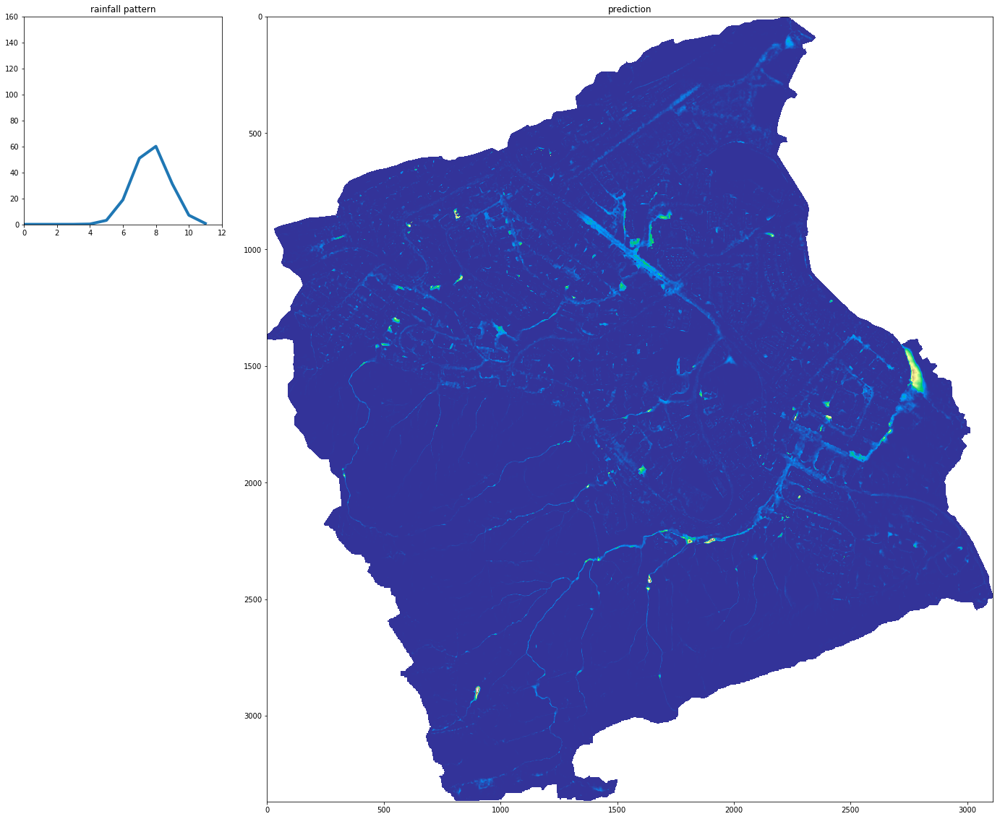

In [14]:
n=vector_length
pattern=norm.pdf(np.arange(n)/(n-1) * 10,7,1)
pattern/=np.max(pattern)
pattern*=60

wd = make_prediction(dem_array, pattern, method="median", patch_step = patch_size // 2)
render_prediction2(mask_indice, wd, pattern, threshold=None)

measure avg time spent on prediction

In [75]:
method = "median"
step = patch_size//2

n=vector_length
pattern=norm.pdf(np.arange(n)/(n-1) * 10,7,1)
pattern/=np.max(pattern)
pattern*=60

start = time.time()
for _ in range(10):
    make_prediction(dem_array, pattern, method=method, patch_step = step)
end = time.time()

print ((end-start)/10,"s")

c:\users\guo zifeng\appdata\local\programs\python\python35\lib\site-packages\numpy\lib\function_base.py:4033: RuntimeWarning: All-NaN slice encountered
  r = func(a, **kwargs)


14.748797941207886 s


### 3.2 On Generated Rain Pattern

In [12]:
def generate_rain_pattern(mu,sigma,minval,maxval):
    n=vector_length
    pattern=norm.pdf(np.arange(n)/(n-1) * 10,mu,sigma)
    pattern/=np.max(pattern)
    pattern*=(maxval-minval)
    pattern+=minval
    
    return pattern

def interactive_generate_rain_pattern(mu,sigma,minval,maxval, threshold=None,patch_step=patch_size):
    pattern = generate_rain_pattern(mu,sigma,minval,maxval)
    result = make_prediction(dem_array, pattern,patch_step=patch_step)
    render_prediction2(mask_indice, result, pattern, threshold=threshold)

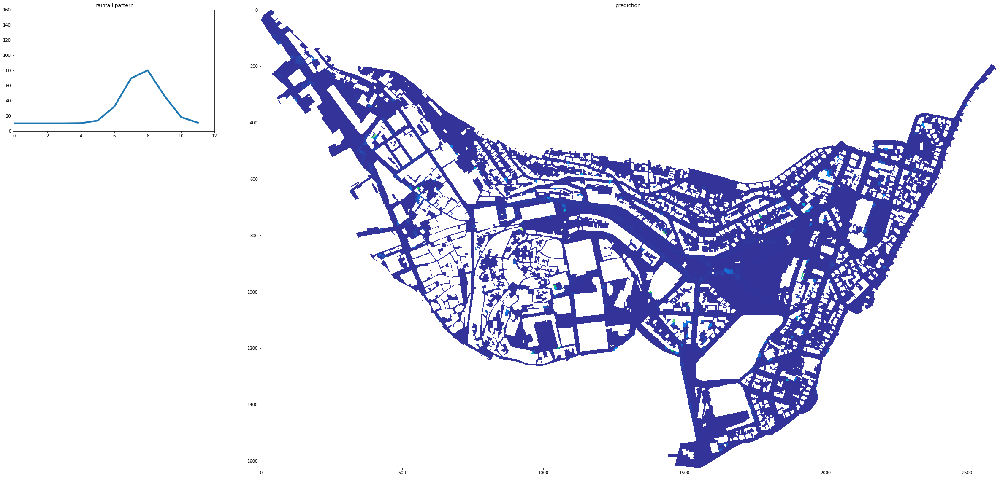

In [57]:
interactive_generate_rain_pattern(7,1,10,80,None)

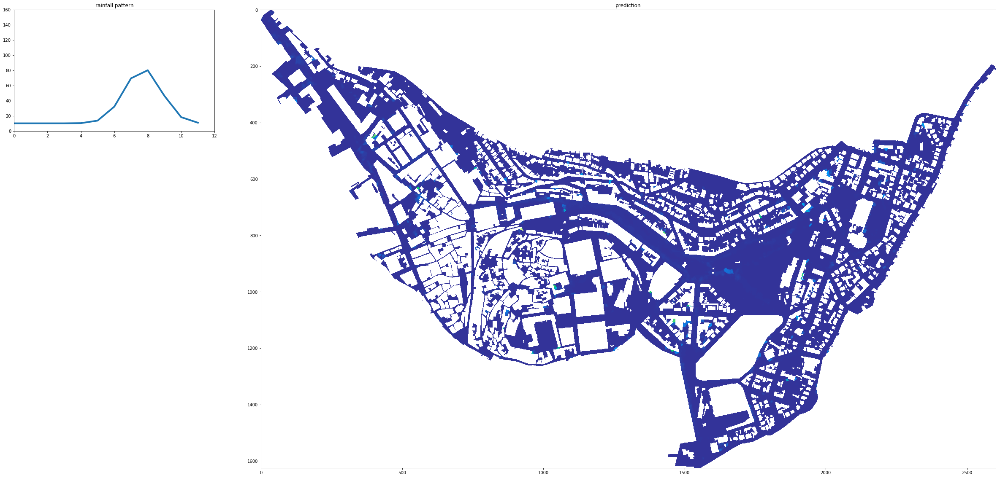

In [30]:
interactive_generate_rain_pattern(7,1,10,80,None,128)

interactive version

In [70]:
interact(interactive_generate_rain_pattern,mu=widgets.FloatSlider(min=0,max=vector_length,step=0.5,value=vector_length/2),sigma=widgets.FloatSlider(min=0.1,max=2,step=0.1,value=0.1),minval=widgets.IntSlider(min=0,max=40,step=10,value=20),maxval=widgets.IntSlider(min=80,max=160,step=10,value=80),threshold=[["None",None],["0.5m",0.5],["1m",1]], patch_step=widgets.IntSlider(min=patch_size//4,max=patch_size,step=32,value=patch_size))

interactive(children=(FloatSlider(value=6.0, description='mu', max=12.0, step=0.5), FloatSlider(value=0.1, des…

<function __main__.interactive_generate_rain_pattern>

### 3.3 On Testset

In [14]:
random_seed = 1 # random seed used for training the model

np.random.seed(random_seed)

rainfall_index = np.array([k for k in rainfall_name.keys()],dtype=np.int32)

np.random.shuffle(rainfall_index)
test_pattern_index = rainfall_index[:len(rainfall_index)//3] # 6
test_pattern_name = [rainfall_name[i] for i in test_pattern_index]

print(test_pattern_index, test_pattern_name)
# for zurich-744 512x512, it should be [ 6  3 13  2 14  7] ['tr2-2', 'tr20', 'tr5-3', 'tr10', 'tr10-3', 'tr5-2']

[ 6  3 13  2 14  7] ['tr2-2', 'tr20', 'tr5-3', 'tr10', 'tr10-3', 'tr5-2']


In [13]:
def interactive_test_rain_pattern(pattern_index):
    pattern=rainfall_intensity[pattern_index]
    target_array = load_data.load_waterdepth(waterdepth_path, [rainfall_name[pattern_index]])
    result = make_prediction(dem_array, pattern)
    render_prediction(mask_indice, result, pattern, target_array = target_array)

loading luzern_tr5_WDraster_PEAK.asc.gz
(3369, 3110)


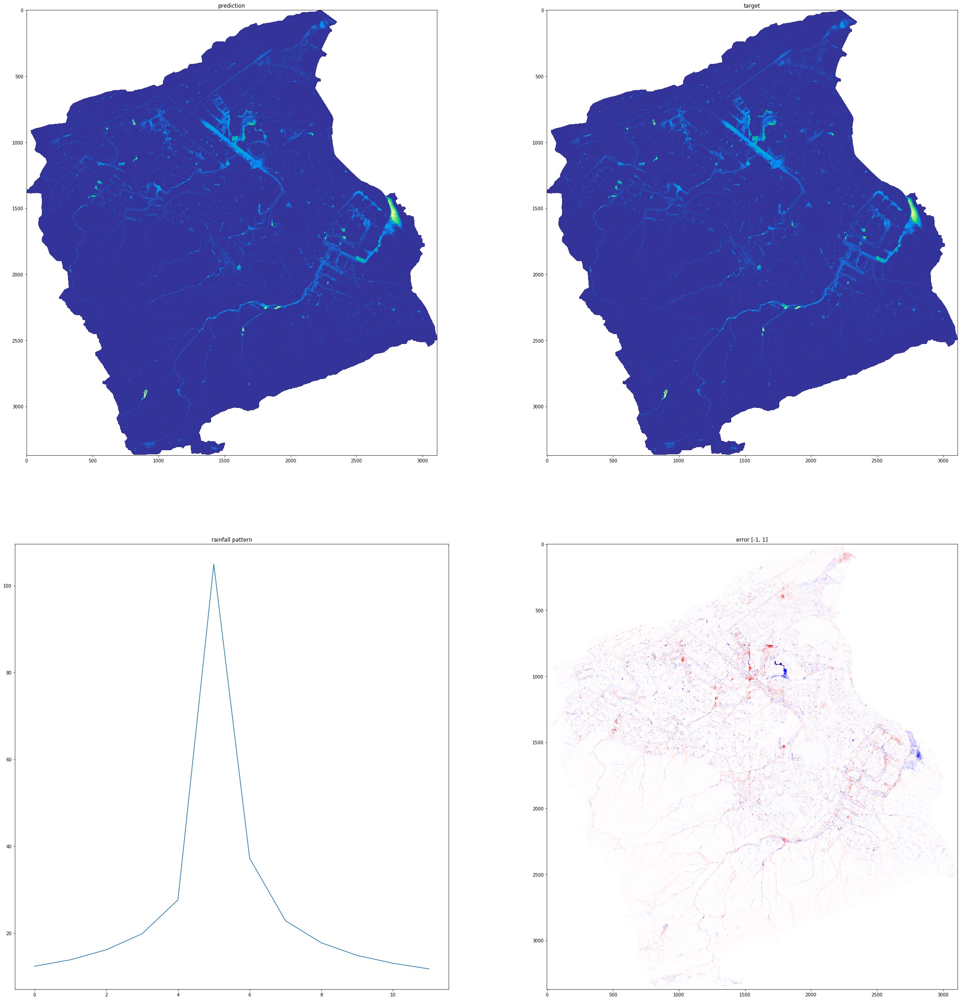

In [169]:
interactive_test_rain_pattern(1)

In [19]:
interact(interactive_test_rain_pattern,pattern_index=[[test_pattern_name[i],test_pattern_index[i]] for i in range(len(test_pattern_index))])

interactive(children=(Dropdown(description='pattern_index', options=(['tr2-2', 6], ['tr20', 3], ['tr5-3', 13],…

<function __main__.test_rain_pattern>

### 3.4 For Paper - Real Rain

generate prediction results for real rain pattern

In [15]:
step = patch_size//2
method = "mean"
for i in rainfall_name.keys():                
    # target_array = load_data.load_waterdepth(waterdepth_path, [rainfall_name[i]])
    result = make_prediction(dem_array, rainfall_intensity[i], method = method, patch_step = step)
    name = model_name + (" overlap" if step < patch_size else " non-overlap") + " " + method + " " + rainfall_name[i]
    print(name)
    np.save("for_paper/predictions/" + name + ".npy", result)

coimbra_256_features overlap mean 21-09-08
coimbra_256_features overlap mean 09-06-06
coimbra_256_features overlap mean 29-04-11


In [6]:
target_array_all = [load_data.load_waterdepth(waterdepth_path, [rainfall_name[i]]) for i in rainfall_name.keys()]

loading _21-09-08_WDraster.asc
(1625, 2603)
loading _09-06-06_WDraster.asc
(1625, 2603)
loading _29-04-11_WDraster.asc
(1625, 2603)


render predictions, errors and histograms

In [11]:
h,w,_ = dem_array.shape
step = patch_size//2
method = "mean"

for i in rainfall_name.keys():                
    target_array = target_array_all[i]
    name = model_name + (" overlap" if step < patch_size else " non-overlap") + " " + method + " " + rainfall_name[i]
    result = np.load("for_paper/predictions/" + name + ".npy")
    print(name)
    
    err = result - target_array
    
    img=render(err, plt.cm.terrain, vmin=-0.3, vmax=0.3, mask_indice=mask_indice)
    save_png("for_paper/" + name + " error.png",img)

    img=render(result, plt.cm.terrain, vmin=0, vmax=3, mask_indice=mask_indice)
    save_png("for_paper/" + name + " prediction.png",img)

    img=render(target_array, plt.cm.terrain, vmin=0, vmax=3, mask_indice=mask_indice)
    save_png("for_paper/" + name + " simulation.png",img)
    
    indices = np.logical_not(mask_indice)
    
    plt.figure(figsize=(6,4))
    
    plt.hist(err[indices], bins=[0.1*(i-40/2) for i in range(41)], color="gray", rwidth=0.85)
    plt.yscale("log")
    plt.ylim((1, h*w))

    plt.xlabel('Prediction Error (Meters)',fontsize=16)
    plt.ylabel('Frequency',fontsize=16)

    plt.suptitle("Prediction Error Histogram of Event " + str(i), fontsize=20)
    plt.savefig('for_paper/' + model_name + '_hist_' + rainfall_name[i] + '.png', dpi=300)
    plt.close()
    
    plt.figure(figsize=(5,4))
    plt.axis([0,12,0,160])
    plt.suptitle("Rainfall Event " + str(i), fontsize=20)
    plt.plot(12 * np.arange(len(rainfall_intensity_orig[i])) / (len(rainfall_intensity_orig[i])-1), rainfall_intensity_orig[i],lw=2,label="original")
    plt.plot(12 * np.arange(12) / 11, rainfall_intensity[i],lw=2,label="resampled")
    plt.xticks(np.arange(0,16,4),[str(x)+"min" for x in range(0,80,20)])
    plt.legend()
    
    plt.xlabel('Time',fontsize=16)
    plt.ylabel('Intensity(mm/h)',fontsize=16)
    plt.savefig("for_paper/"+ model_name + '_plot_' + rainfall_name[i] + '.png', dpi=300)
    plt.close()

coimbra_256_features overlap mean 21-09-08
coimbra_256_features overlap mean 09-06-06
coimbra_256_features overlap mean 29-04-11


### 3.5 For Paper - Designed Rain, Predictions and Analysis

calculate stddev for overlapping patches

In [104]:
for step in [patch_size//2]:
    for method in (["stddev"]):
        for i in [9]:                
            # target_array = load_data.load_waterdepth(waterdepth_path, [rainfall_name[i]])
            result = make_prediction(dem_array, rainfall_intensity[i], method = method, patch_step = step)
            name = model_name + " " + method + " " + rainfall_name[i]
            print(name)
            np.save("for_paper/predictions/" + name + ".npy", result)

coimbra_256_features stddev tr20-2


generate the prediction results using differernt combinations

In [15]:
for step in [patch_size, patch_size//2]:
    for method in (["max"] if step == patch_size else ["max", "mean", "median"]):
        for i in rainfall_name.keys():                
            # target_array = load_data.load_waterdepth(waterdepth_path, [rainfall_name[i]])
            result = make_prediction(dem_array, rainfall_intensity[i], method = method, patch_step = step)
            name = model_name + (" overlap" if step < patch_size else " non-overlap") + " " + method + " " + rainfall_name[i]
            print(name)
            np.save("for_paper/predictions/" + name + ".npy", result)

coimbra_256_features non-overlap max tr2-1
coimbra_256_features non-overlap max tr5-1
coimbra_256_features non-overlap max tr10-1
coimbra_256_features non-overlap max tr20-1
coimbra_256_features non-overlap max tr50-1
coimbra_256_features non-overlap max tr100-1
coimbra_256_features non-overlap max tr2-2
coimbra_256_features non-overlap max tr5-2
coimbra_256_features non-overlap max tr10-2
coimbra_256_features non-overlap max tr20-2
coimbra_256_features non-overlap max tr50-2
coimbra_256_features non-overlap max tr100-2
coimbra_256_features non-overlap max tr2-3
coimbra_256_features non-overlap max tr5-3
coimbra_256_features non-overlap max tr10-3
coimbra_256_features non-overlap max tr50-3
coimbra_256_features non-overlap max tr100-3
coimbra_256_features overlap max tr2-1
coimbra_256_features overlap max tr5-1
coimbra_256_features overlap max tr10-1
coimbra_256_features overlap max tr20-1
coimbra_256_features overlap max tr50-1
coimbra_256_features overlap max tr100-1
coimbra_256_feat

c:\users\guo zifeng\appdata\local\programs\python\python35\lib\site-packages\numpy\lib\function_base.py:4033: RuntimeWarning: All-NaN slice encountered
  r = func(a, **kwargs)


coimbra_256_features overlap median tr2-1
coimbra_256_features overlap median tr5-1
coimbra_256_features overlap median tr10-1
coimbra_256_features overlap median tr20-1
coimbra_256_features overlap median tr50-1
coimbra_256_features overlap median tr100-1
coimbra_256_features overlap median tr2-2
coimbra_256_features overlap median tr5-2
coimbra_256_features overlap median tr10-2
coimbra_256_features overlap median tr20-2
coimbra_256_features overlap median tr50-2
coimbra_256_features overlap median tr100-2
coimbra_256_features overlap median tr2-3
coimbra_256_features overlap median tr5-3
coimbra_256_features overlap median tr10-3
coimbra_256_features overlap median tr50-3
coimbra_256_features overlap median tr100-3


spatial distribution of the prediction / error and stddev

In [55]:
for step in [patch_size//2]:
    for method in (["mean"]):
        all_loss = []
        label = "no overlaps" if step == patch_size else method
        for i in [9]:
            name = model_name + (" overlap" if step < patch_size else " non-overlap") + " " + method + " " + rainfall_name[i]
            print(name)
            result = np.load("for_paper/predictions/" + name + ".npy")
            target_array = load_data.load_waterdepth(waterdepth_path, [rainfall_name[i]])
            err = result - target_array
            
            print (err.min(), err.max())
            img=render(err, plt.cm.terrain, vmin=-0.3, vmax=0.3, mask_indice=mask_indice)
            save_png("for_paper/predictions/" + name + " error.png",img)
            
            img=render(result, plt.cm.terrain, vmin=0, vmax=3, mask_indice=mask_indice)
            save_png("for_paper/predictions/" + name + " prediction.png",img)
            
            name = model_name + " stddev " + rainfall_name[i]
            arr = np.load("for_paper/predictions/" + name + ".npy")
            print (arr.max())
            img=render(arr, plt.cm.terrain, vmin=0, vmax=0.3, mask_indice=mask_indice)
            save_png("for_paper/predictions/" + name + ".png",img)

zurich_256_features overlap mean tr20-2
loading 744_tr20-2_WDraster_PEAK.asc.gz
(6175, 6050)
-3.885582 3.620454
1.8663396


the color bar

In [75]:
plt.figure(figsize=(3,3))
plt.imshow([[0,1,2]],plt.cm.terrain, vmin=0, vmax=3)
ticks = [0,1,2,3]
plt.colorbar(ticks=ticks).set_ticklabels([str(i) + "m" for i in ticks])
plt.savefig("for_paper/c3.png",dpi=600)
plt.close()

load all ground truth

In [107]:
target_array_all = [load_data.load_waterdepth(waterdepth_path, [rainfall_name[i]]) for i in rainfall_name.keys()]

loading _21-09-08_WDraster.asc
(1625, 2603)
loading _09-06-06_WDraster.asc
(1625, 2603)
loading _29-04-11_WDraster.asc
(1625, 2603)


box plot of the prediction error

In [43]:
# see the link below for configuring box plot
# https://stackoverflow.com/questions/41997493/python-matplotlib-boxplot-color

plt.figure(figsize=(15,5))

flierprops = dict(marker="o")#,markeredgewidth=0.1)
min_val = 10000
max_val = 0
thres = 0.01

ci=0
ckeys=plt.rcParams['axes.prop_cycle'].by_key()['color']

offset_step = 0.15
offset = -offset_step * 1.5
box_width = 0.5/4

for step in [patch_size, patch_size//2]:
    for method in (["max"] if step == patch_size else ["max", "mean", "median"]):
        all_loss = []
        for i in rainfall_name.keys():                
            label = "no overlaps" if step == patch_size else method

            name = model_name + (" overlap" if step < patch_size else " non-overlap") + " " + method + " " + rainfall_name[i]
            print(name)
            result = np.load("for_paper/predictions/" + name + ".npy")
            
            target_array = target_array_all[i]
            indice = np.logical_or(target_array>thres,result>thres)
            err = (result[indice] - target_array[indice]).flatten()
            #err = (result - target_array).flatten()
            all_loss.append(np.abs(err))
        c = ckeys[ci]
        plt.boxplot(all_loss,widths=box_width,positions=offset+np.arange(len(all_loss)),showfliers=True,patch_artist=True,boxprops=dict(facecolor=c, color=c),capprops=dict(color=c),whiskerprops=dict(color=c),flierprops=dict(marker=".", markeredgecolor=c, markeredgewidth=0.1),medianprops=dict(color="white"))
        ci += 1
        offset += offset_step
        
plt.xticks(list(rainfall_name.keys()),list(rainfall_name.values()))
plt.yscale("symlog",linthreshy=0.01,linscaley=1)
plt.xlabel('Rainfall Pattern',fontsize=16)
plt.ylabel('Average Prediction Error',fontsize=16)
plt.suptitle(model_name.split("_")[0].title() + " Prediction Error", fontsize=20)
#range_y = max_val - min_val
#plt.ylim((min_val-range_y/4, max_val + range_y/4))
plt.xlim((-1,len(rainfall_name)))

#plt.legend()
plt.savefig('for_paper/TEST2.png', dpi=300)
plt.close()

luzern_256_features non-overlap max tr2
luzern_256_features non-overlap max tr5
luzern_256_features non-overlap max tr10
luzern_256_features non-overlap max tr20
luzern_256_features non-overlap max tr50
luzern_256_features non-overlap max tr100
luzern_256_features non-overlap max tr2-2
luzern_256_features non-overlap max tr5-2
luzern_256_features non-overlap max tr10-2
luzern_256_features non-overlap max tr20-2
luzern_256_features non-overlap max tr50-2
luzern_256_features non-overlap max tr100-2
luzern_256_features non-overlap max tr2-3
luzern_256_features non-overlap max tr5-3
luzern_256_features non-overlap max tr10-3
luzern_256_features non-overlap max tr20-3
luzern_256_features non-overlap max tr50-3
luzern_256_features non-overlap max tr100-3
luzern_256_features overlap max tr2
luzern_256_features overlap max tr5
luzern_256_features overlap max tr10
luzern_256_features overlap max tr20
luzern_256_features overlap max tr50
luzern_256_features overlap max tr100
luzern_256_features 

point-line plot of the prediction error

In [12]:
plt.figure(figsize=(15,5))

min_val = 10000
max_val = 0
thres = 0.01

for step in [patch_size, patch_size//2]:
    for method in (["max"] if step == patch_size else ["max", "mean", "median"]):
        all_loss = []
        for i in rainfall_name.keys():                
            label = "no overlaps" if step == patch_size else method
                
            # pattern=rainfall_intensity[i]
            # result = make_prediction(dem_array, pattern, method = method, patch_step = step)
            # target_array = load_data.load_waterdepth(waterdepth_path, [rainfall_name[i]])

            name = model_name + (" overlap" if step < patch_size else " non-overlap") + " " + method + " " + rainfall_name[i]
            print(name)
            result = np.load("for_paper/predictions/" + name + ".npy")
            
            target_array = target_array_all[i]
            indice = np.logical_or(target_array>thres,result>thres)
            err = (result[indice] - target_array[indice]).flatten()
            
            all_loss.append(np.abs(err).mean())

        max_val = max(max_val, max(all_loss))
        min_val = min(min_val, min(all_loss))

        plt.scatter(range(len(all_loss)),all_loss, label=label, s=10)
        plt.plot(range(len(all_loss)),all_loss, lw=1)
        
plt.xticks(list(rainfall_name.keys()),list(rainfall_name.values()))
plt.xlabel('Rainfall Pattern',fontsize=16)
plt.ylabel('Average Prediction Error',fontsize=16)
plt.suptitle(model_name.split("_")[0].title() + " Prediction Error", fontsize=20)

range_y = max_val - min_val
plt.ylim((min_val-range_y/4, max_val + range_y/4))

plt.legend()
plt.savefig('for_paper/' + model_name + " loss.png", dpi=300)
plt.close()

loading 744_tr2_WDraster_PEAK.asc.gz
(6175, 6050)
loading 744_tr5_WDraster_PEAK.asc.gz
(6175, 6050)
loading 744_tr10_WDraster_PEAK.asc.gz
(6175, 6050)
loading 744_tr20_WDraster_PEAK.asc.gz
(6175, 6050)
loading 744_tr50_WDraster_PEAK.asc.gz
(6175, 6050)
loading 744_tr100_WDraster_PEAK.asc.gz
(6175, 6050)
loading 744_tr2-2_WDraster_PEAK.asc.gz
(6175, 6050)
loading 744_tr5-2_WDraster_PEAK.asc.gz
(6175, 6050)
loading 744_tr10-2_WDraster_PEAK.asc.gz
(6175, 6050)
loading 744_tr20-2_WDraster_PEAK.asc.gz
(6175, 6050)
loading 744_tr50-2_WDraster_PEAK.asc.gz
(6175, 6050)
loading 744_tr100-2_WDraster_PEAK.asc.gz
(6175, 6050)
loading 744_tr2-3_WDraster_PEAK.asc.gz
(6175, 6050)
loading 744_tr5-3_WDraster_PEAK.asc.gz
(6175, 6050)
loading 744_tr10-3_WDraster_PEAK.asc.gz
(6175, 6050)
loading 744_tr20-3_WDraster_PEAK.asc.gz
(6175, 6050)
loading 744_tr50-3_WDraster_PEAK.asc.gz
(6175, 6050)
loading 744_tr100-3_WDraster_PEAK.asc.gz
(6175, 6050)
zurich_256_features non-overlap max tr2
zurich_256_features n

bar plot of the prediction error

In [14]:
plt.figure(figsize=(15,4))

min_val = 10000
max_val = 0
thres = 0.01

offset_step = 0.15
offset = -offset_step * 1.5
box_width = 0.5/4

for step in [patch_size, patch_size//2]:
    for method in (["max"] if step == patch_size else ["max", "mean", "median"]):
        all_loss = []
        for i in rainfall_name.keys():                
            label = "no overlaps" if step == patch_size else "use "+ method + " value"
                
            # pattern=rainfall_intensity[i]
            # result = make_prediction(dem_array, pattern, method = method, patch_step = step)
            # target_array = load_data.load_waterdepth(waterdepth_path, [rainfall_name[i]])

            name = model_name + (" overlap" if step < patch_size else " non-overlap") + " " + method + " " + rainfall_name[i]
            print(name)
            result = np.load("for_paper/predictions/" + name + ".npy")
            
            target_array = target_array_all[i]
            indice = np.logical_or(target_array>thres,result>thres)
            err = (result[indice] - target_array[indice]).flatten()
            
            all_loss.append(np.abs(err).mean())

        max_val = max(max_val, max(all_loss))
        min_val = min(min_val, min(all_loss))

        plt.bar(offset+np.arange(len(all_loss)),all_loss, label=label, width=box_width)
        offset += offset_step
        
plt.xticks(list(rainfall_name.keys()),list(rainfall_name.values()))
plt.xlabel('Rainfall Pattern',fontsize=16)
plt.ylabel('Average Prediction Error',fontsize=16)
plt.suptitle(model_name.split("_")[0].title() + " Prediction Error", fontsize=20)

range_y = max_val - min_val
plt.ylim((min_val-range_y/4, max_val + range_y/4))

plt.legend()
plt.savefig('for_paper/' + model_name + " loss bar.png", dpi=300)
plt.close()

coimbra_256_features non-overlap max tr2-1
coimbra_256_features non-overlap max tr5-1
coimbra_256_features non-overlap max tr10-1
coimbra_256_features non-overlap max tr20-1
coimbra_256_features non-overlap max tr50-1
coimbra_256_features non-overlap max tr100-1
coimbra_256_features non-overlap max tr2-2
coimbra_256_features non-overlap max tr5-2
coimbra_256_features non-overlap max tr10-2
coimbra_256_features non-overlap max tr20-2
coimbra_256_features non-overlap max tr50-2
coimbra_256_features non-overlap max tr100-2
coimbra_256_features non-overlap max tr2-3
coimbra_256_features non-overlap max tr5-3
coimbra_256_features non-overlap max tr10-3
coimbra_256_features non-overlap max tr50-3
coimbra_256_features non-overlap max tr100-3
coimbra_256_features overlap max tr2-1
coimbra_256_features overlap max tr5-1
coimbra_256_features overlap max tr10-1
coimbra_256_features overlap max tr20-1
coimbra_256_features overlap max tr50-1
coimbra_256_features overlap max tr100-1
coimbra_256_feat

histo of all prediction error

In [73]:
h, w, _ = dem_array.shape

plt.figure(figsize=(8,4))
m=1
thres = 0.01

all_labels=[]
all_err = []
for step in [patch_size, patch_size//2]:
    for method in (["max"] if step == patch_size else ["max", "mean", "median"]):
        flt_err = np.array([])
        label = "no overlaps" if step == patch_size else "use "+ method + " value"
        for i in rainfall_name.keys():                
            name = model_name + (" overlap" if step < patch_size else " non-overlap") + " " + method + " " + rainfall_name[i]
            print(name)
            result = np.load("for_paper/predictions/" + name + ".npy")
            
            target_array = target_array_all[i]
            indice = np.logical_or(target_array>thres,result>thres)
            
            err = (result[indice] - target_array[indice]).flatten()
            flt_err = np.concatenate((flt_err, err), axis=None)
            
        all_err.append(flt_err)
        all_labels.append(label)
        
#         plt.subplot(1,4,m)
#         plt.hist(flt_err, bins=[0.2*(i-40/2) for i in range(41)], color = "gray", rwidth=0.85)
#         plt.yscale("log")
#         plt.ylim((1, len(flt_err)))
        
#         plt.xlabel('Prediction Error (Meters)',fontsize=16)
#         plt.ylabel('Frequency',fontsize=16)
        
#         plt.title(label.title(), fontsize=16)
#         m+=1

print (len(all_err))

plt.hist(all_err, bins=[0.5*(i-15/2) for i in range(16)], label=all_labels, rwidth=0.85)
plt.yscale("log")
plt.ylim((1, h*w*len(rainfall_name.keys())))

plt.xlabel('Prediction Error (Meters)',fontsize=16)
plt.ylabel('Frequency',fontsize=16)

plt.suptitle("Prediction Error Histogram of " + model_name.split("_")[0].title(), fontsize=20)
plt.legend()
plt.savefig('for_paper/' + model_name + '_hist_all_methods.png', dpi=300)
plt.close()

coimbra_256_features non-overlap max tr2-1
coimbra_256_features non-overlap max tr5-1
coimbra_256_features non-overlap max tr10-1
coimbra_256_features non-overlap max tr20-1
coimbra_256_features non-overlap max tr50-1
coimbra_256_features non-overlap max tr100-1
coimbra_256_features non-overlap max tr2-2
coimbra_256_features non-overlap max tr5-2
coimbra_256_features non-overlap max tr10-2
coimbra_256_features non-overlap max tr20-2
coimbra_256_features non-overlap max tr50-2
coimbra_256_features non-overlap max tr100-2
coimbra_256_features non-overlap max tr2-3
coimbra_256_features non-overlap max tr5-3
coimbra_256_features non-overlap max tr10-3
coimbra_256_features non-overlap max tr50-3
coimbra_256_features non-overlap max tr100-3
coimbra_256_features overlap max tr2-1
coimbra_256_features overlap max tr5-1
coimbra_256_features overlap max tr10-1
coimbra_256_features overlap max tr20-1
coimbra_256_features overlap max tr50-1
coimbra_256_features overlap max tr100-1
coimbra_256_feat

In [111]:
h, w, _ = dem_array.shape

for step in [patch_size, patch_size//2]:
    for method in (["max"] if step == patch_size else ["max", "mean", "median"]):
        all_loss = []
        for i in rainfall_name.keys():                
            label = "no overlaps" if step == patch_size else method
                
            pattern=rainfall_intensity[i]
            target_array = load_data.load_waterdepth(waterdepth_path, [rainfall_name[i]])
            result = make_prediction(dem_array, pattern, method = method, patch_step = step)
            
            err = (result - target_array).flatten()
            name = model_name.split("_")[0] + (" overlap" if step < patch_size else " non-overlap") + " " + method + " " + rainfall_name[i]
            plt.figure(figsize=(8,6))
            plt.hist(err, bins=[0.15*(i-40/2) for i in range(41)], color = "gray", rwidth=0.85)
            plt.yscale("log")
            plt.ylim((1, h * w))
            plt.savefig('for_paper/' + name + " " + str(np.abs(err).mean()) + ".png", dpi=300)
            plt.close()

loading portugal_tr2-1_WDraster.asc.gz
(1625, 2603)
loading portugal_tr5-1_WDraster.asc.gz
(1625, 2603)
loading portugal_tr10-1_WDraster.asc.gz
(1625, 2603)
loading portugal_tr20-1_WDraster.asc.gz
(1625, 2603)
loading portugal_tr50-1_WDraster.asc.gz
(1625, 2603)
loading portugal_tr100-1_WDraster.asc.gz
(1625, 2603)
loading portugal_tr2-2_WDraster.asc.gz
(1625, 2603)
loading portugal_tr5-2_WDraster.asc.gz
(1625, 2603)
loading portugal_tr10-2_WDraster.asc.gz
(1625, 2603)
loading portugal_tr20-2_WDraster.asc.gz
(1625, 2603)
loading portugal_tr50-2_WDraster.asc.gz
(1625, 2603)
loading portugal_tr100-2_WDraster.asc.gz
(1625, 2603)
loading portugal_tr2-3_WDraster.asc.gz
(1625, 2603)
loading portugal_tr5-3_WDraster.asc.gz
(1625, 2603)
loading portugal_tr10-3_WDraster.asc.gz
(1625, 2603)
loading portugal_tr50-3_WDraster.asc.gz
(1625, 2603)
loading portugal_tr100-3_WDraster.asc.gz
(1625, 2603)
loading portugal_tr2-1_WDraster.asc.gz
(1625, 2603)
loading portugal_tr5-1_WDraster.asc.gz
(1625, 2603

c:\users\guo zifeng\appdata\local\programs\python\python35\lib\site-packages\numpy\lib\function_base.py:4033: RuntimeWarning: All-NaN slice encountered
  r = func(a, **kwargs)


loading portugal_tr5-1_WDraster.asc.gz
(1625, 2603)
loading portugal_tr10-1_WDraster.asc.gz
(1625, 2603)
loading portugal_tr20-1_WDraster.asc.gz
(1625, 2603)
loading portugal_tr50-1_WDraster.asc.gz
(1625, 2603)
loading portugal_tr100-1_WDraster.asc.gz
(1625, 2603)
loading portugal_tr2-2_WDraster.asc.gz
(1625, 2603)
loading portugal_tr5-2_WDraster.asc.gz
(1625, 2603)
loading portugal_tr10-2_WDraster.asc.gz
(1625, 2603)
loading portugal_tr20-2_WDraster.asc.gz
(1625, 2603)
loading portugal_tr50-2_WDraster.asc.gz
(1625, 2603)
loading portugal_tr100-2_WDraster.asc.gz
(1625, 2603)
loading portugal_tr2-3_WDraster.asc.gz
(1625, 2603)
loading portugal_tr5-3_WDraster.asc.gz
(1625, 2603)
loading portugal_tr10-3_WDraster.asc.gz
(1625, 2603)
loading portugal_tr50-3_WDraster.asc.gz
(1625, 2603)
loading portugal_tr100-3_WDraster.asc.gz
(1625, 2603)


### 3.6 For Paper - Any Rain, Prediction + Rendering

make prediction on a generated rain pattern

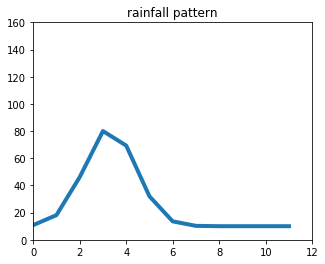

In [33]:
pattern=generate_rain_pattern(3,1,10,80)
plt.figure(figsize=(5,4))
plt.axis([0,12,0,160])
plt.gca().set_title("rainfall pattern")
plt.plot(pattern,lw=4)
plt.savefig("test3.png")

In [25]:
thres=0.1
vmax=2

# mu,sigma,minval,maxval
for sigma in range (1,4,1):
    minval=10
    for maxval in range(80, 161, 80):
        filename = "6_"+str(sigma)+"_"+str(minval)+"_"+str(maxval)

        print(filename)

        pattern=generate_rain_pattern(6,sigma,minval,maxval)
        plt.figure(figsize=(5,4))
        plt.axis([0,12,0,180])
        # plt.suptitle("Rainfall Event " + str(i), fontsize=20)

        plt.plot(pattern,lw=2)
        plt.xticks(np.arange(0,16,4),[str(x)+("" if x < 60 else "min") for x in range(0,80,20)])
        plt.yticks(np.arange(0,200,20),[("" if x <180 else "mm/h\n") + str(x) for x in range(0,200,20)])
        
        #plt.xlabel('Time',fontsize=16)
        #plt.ylabel('Intensity(mm/h)',fontsize=16)
        
        plt.savefig("for_paper/"+filename+"-pattern.png", dpi=300)
        plt.close()

        result=make_prediction(dem_array, pattern, method = "mean", patch_step = patch_size//3)
        img=render_by_threshold(result,thres,mask_indice=mask_indice)
        save_png("for_paper/"+filename+"-"+str(thres)+"m.png",img)

        img = cv2.resize(img,None,fx=0.2, fy=0.2, interpolation = cv2.INTER_CUBIC)
        save_png("for_paper/"+filename+"-"+str(thres)+"m_small.png",img)

        img=render(result,plt.cm.terrain,vmin=0,vmax=vmax,mask_indice=mask_indice)
        save_png("for_paper/"+filename+"-abs.png",img)

        img = cv2.resize(img,None,fx=0.2, fy=0.2, interpolation = cv2.INTER_CUBIC)
        save_png("for_paper/"+filename+"-abs_small.png",img)

6_1_10_80
6_1_10_160
6_2_10_80
6_2_10_160
6_3_10_80
6_3_10_160


make prediction on designed rain pattern

In [91]:
for i in rainfall_name.keys():
    if rainfall_name[i] != "tr10-3":
        continue
        
    filename = rainfall_name[i] + " " + model_name
    print (filename)
    
    pattern=rainfall_intensity[i]
    target_array = load_data.load_waterdepth(waterdepth_path, [rainfall_name[i]])
    result = make_prediction(dem_array, pattern, method="mean", patch_step = patch_size//3)

    img=render(result, plt.cm.terrain, vmin=0, vmax=2, mask_indice=mask_indice)
    save_png("for_paper/"+filename+"_prediction.png",img)
    
    img=render(target_array, plt.cm.terrain, vmin=0, vmax=2, mask_indice=mask_indice)
    save_png("for_paper/"+filename+"_truth.png",img)

    img=render(result-target_array, plt.cm.seismic, vmin=-0.5, vmax=0.5, mask_indice=mask_indice)
    save_png("for_paper/"+filename+"_error.png",img)

tr10-3 luzern_256_features
loading luzern_tr10-3_WDraster_PEAK.asc.gz
(3369, 3110)
